In [2]:
import os
import sys
import json
import pandas as pd
import numpy as np
import h5py
from collections import defaultdict
import matplotlib.pyplot as plt
from pathlib import Path
from pyfonts import load_font
import tsfel
from tslearn.clustering import TimeSeriesKMeans, KernelKMeans, KShape

dataset_path = r"C:\Users\lhauptmann\Code\WristPPG2\data\dataset"

cmap = plt.get_cmap('Dark2')

global FONT
FONT = load_font(
   font_path="../../../Documents/Raleway/static/Raleway-Medium.ttf"
)

plot_args = {"fontproperties":FONT, "fontsize": 32}


In [3]:
def import_hdf5_session(file_path, fixed_length:int=None, padding=False, add_margin = 0, shift = 0, min_length = 100):
    samples = []
    with h5py.File(file_path, 'r') as f:
        data_dict = f["data"]
        
        acc_mag = np.sqrt(data_dict["acc_x"][:]**2 + data_dict["acc_y"][:]**2 + data_dict["acc_z"][:]**2)
        acc_mag_abs = np.abs((acc_mag - np.mean(acc_mag)) / np.std(acc_mag))
        for key in f.keys():
            if key != "data":
                start_index = f[key]["start_index"][()]
                end_index = f[key]["end_index"][()]
                if start_index == end_index:
                    continue
                if end_index - start_index < min_length:
                    add_margin_start = (min_length - (end_index - start_index)) // 2
                    add_margin_end = min_length - (end_index - start_index) - add_margin_start
                    start_index -= add_margin_start
                    end_index += add_margin_end
                    
                start_index -= add_margin
                end_index += add_margin
                start_index += shift
                end_index += shift
                
                sample = {}
            
                for modality in data_dict.keys():
                    sample[modality] = data_dict[modality][start_index:end_index]
                    #sample[modality] = (sample[modality] - np.mean(sample[modality])) / np.std(sample[modality])
                    if fixed_length and end_index - start_index < fixed_length:
                        pad_start = (fixed_length - (end_index - start_index)) // 2
                        pad_end = fixed_length - (end_index - start_index) - pad_start
                        if padding:
                            sample[modality] = np.pad(data_dict[modality][start_index:end_index], (pad_start, pad_end), "mean")
                        else:
                            sample[modality] = data_dict[modality][start_index-pad_start:end_index+pad_end]
                    elif fixed_length and end_index - start_index > fixed_length:
                        # too long
                        cut_start = (end_index - start_index - fixed_length) // 2
                        cut_end = end_index - start_index - fixed_length - cut_start
                        sample[modality] = data_dict[modality][start_index + cut_start: end_index-cut_end]
                        
                    
                    
                sample["participant"] = os.path.basename(file_path).split("_")[1]
                sample["session"] = os.path.basename(file_path).split("_")[2].replace(".hdf5", "")
                sample["label"] = key.split("_")[0]
                
                samples.append(sample)
    return samples


def import_hdf5_sequences(file_path,):
    sample = {}
    with h5py.File(file_path, 'r') as f:
        
        data_dict = f["data"]
        for key in data_dict:
            sample[key] = data_dict[key][:]  
                    
        sample["participant"] = os.path.basename(file_path).split("_")[1]
        sample["session"] = os.path.basename(file_path).split("_")[2].replace(".hdf5", "")
        sample["label"] = [el.split("_")[0] for el in f.keys() if el != "data"]
        sample["label_times"] = [(f[key]["start_time"][()], f[key]["end_time"][()]) for key in f.keys() if key != "data"]
        sample["label_indices"] = [(f[key]["start_index"][()], f[key]["end_index"][()]) for key in f.keys() if key != "data"]
        sample["timestamp"] = [el.split("_")[1] for el in f.keys() if el != "data"]
    return sample

def save_hd5f_sequence(file_path, sample, overwrite=False):
    if not overwrite:
        assert not os.path.exists(file_path), "File already exists"
    with h5py.File(file_path, 'w') as f:
        data_dict = f.create_group("data")
        for key in sample:
            if key == "participant" or key == "session" or key == "label" or key == "label_times" or key == "label_indices" or key == "timestamp":
                continue
            data_dict.create_dataset(key, data=sample[key])
        for i, label in enumerate(sample["label"]):
            label_group = f.create_group(label + "_{}".format(sample["timestamp"][i]))
            label_group.create_dataset("start_time", data=sample["label_times"][i][0])
            label_group.create_dataset("end_time", data=sample["label_times"][i][1])
            label_group.create_dataset("start_index", data=sample["label_indices"][i][0])
            label_group.create_dataset("end_index", data=sample["label_indices"][i][1])
            label_group.create_dataset("label", data=label)
            
    print("Saved to {}".format(file_path))
                
all_participants = [el for el in os.listdir(dataset_path) if os.path.isdir(os.path.join(dataset_path, el))]  
all_files = []
for participant in all_participants:
    participant_path = os.path.join(dataset_path, participant)
    if "exp" in participant or "ppg" in participant:
        continue
    
    all_files += [os.path.join(participant_path, file) for file in os.listdir(participant_path)]       
    



In [4]:
def signal_energy(signal):
    return np.sum(signal ** 2)

def signal_mean(signal):
    return np.mean(signal)

def signal_std(signal):
    return np.std(signal)

def centeredness(signal):
    signal_normalized = np.abs((signal - signal.mean()) / signal.std())
    centroid = (signal_normalized * np.arange(len(signal_normalized))).sum() / signal_normalized.sum()
    return centroid - len(signal_normalized) / 2

def abs_std(signal):
    signal_normalized = np.abs((signal - signal.mean()) / signal.std())
    return np.std(np.abs(signal_normalized))


def compute_magnitudes(samples):
    if "acc_x" in samples[0].keys() and "acc_y" in samples[0].keys() and "acc_z" in samples[0].keys():
        for sample in samples:
            sample["acc"] = np.sqrt(sample["acc_x"] ** 2 + sample["acc_y"] ** 2 + sample["acc_z"] ** 2)
    
    if "gyro_x" in samples[0].keys() and "gyro_y" in samples[0].keys() and "gyro_z" in samples[0].keys():
        for sample in samples:
            sample["gyro"] = np.sqrt(sample["gyro_x"] ** 2 + sample["gyro_y"] ** 2 + sample["gyro_z"] ** 2)
        
    if "acc_ppg_x" in samples[0].keys() and "acc_ppg_y" in samples[0].keys() and "acc_ppg_z" in samples[0].keys():
        for sample in samples:
            sample["acc_ppg"] = np.sqrt(sample["acc_ppg_x"] ** 2 + sample["acc_ppg_y"] ** 2 + sample["acc_ppg_z"] ** 2)
        
    return samples


def compute_derivitatives(samples):
    for sample in samples:
        keys = list(sample.keys())
        for key in keys:
            if key in ["acc", "gyro", "acc_ppg"]:
                sample[key + "_diff"] = np.diff(sample[key])
    return samples

metrics = {
    "energy": signal_energy,
    "mean": signal_mean,
    "std": signal_std,
    "centeredness": centeredness,
    "abs_std": abs_std
}

In [5]:
cfg = tsfel.get_features_by_domain(domain=['statistical', 'temporal', 'spectral'])

In [ ]:
tsfel.time_series_features_extractor

In [30]:
def compute_features(sample):
    cfg = tsfel.get_features_by_domain(domain=['statistical', 'temporal', 'spectral']) # Extracts the temporal, statistical and spectral feature sets.
    acc = np.stack([sample["acc_x"], sample["acc_y"], sample["acc_z"]], axis=1)
    accel_features = tsfel.time_series_features_extractor(cfg, acc, fs=112.2, verbose=0)
    accel_features.columns = ["acc_" + el for el in accel_features.columns]
    
    gyro = np.stack([sample["gyro_x"], sample["gyro_y"], sample["gyro_z"]], axis=1)
    gyro_features = tsfel.time_series_features_extractor(cfg, gyro, fs=112.2, verbose=0)
    gyro_features.columns = ["gyro_" + el for el in gyro_features.columns]
    
    ppg_green = np.stack([sample[key] for key in sample.keys() if "ppg_green" in key], axis=1)
    ppg_green_features = tsfel.time_series_features_extractor(cfg, ppg_green, fs=112.2, verbose=0)
    ppg_green_features.columns = ["ppg_green_" + el for el in ppg_green_features.columns]
    
    ppg_ir = np.stack([sample[key] for key in sample.keys() if "ppg_ir" in key], axis=1)
    ppg_ir_features = tsfel.time_series_features_extractor(cfg, ppg_ir, fs=112.2, verbose=0)
    ppg_ir_features.columns = ["ppg_ir_" + el for el in ppg_ir_features.columns]
    
    features = pd.concat([accel_features, gyro_features, ppg_green_features, ppg_ir_features], axis=1)
    
    return features
    
    

In [34]:
sample_dict = defaultdict(list)

samples = []
features = []
for file in all_files:
        print(file)
        
        samples = import_hdf5_session(file, fixed_length=None, add_margin=0, shift=10, min_length=100)
        for sample in samples:
                feature = compute_features(sample)
                
                for key in sample.keys():
                    if key in ["participant", "session", "label",  "label_times", "labe_indices"]:
                        feature[key] = sample[key]
                features.append(feature)

features = pd.concat(features)

features.to_csv("features.csv", index=False)

C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_alex\participant_alex_1.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_alex\participant_alex_2.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_alex\participant_alex_3.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_alex\participant_alex_4.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_amran\participant_amran_1.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_amran\participant_amran_2.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_amran\participant_amran_3.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_amran\participant_amran_4.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_annamalai\participant_annamalai_1.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_annamalai\participant_annamalai_2.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_annamalai\participant_

c:\Users\lhauptmann\AppData\Local\anaconda3\envs\ppg_stream2\Lib\site-packages\tsfel\feature_extraction\features.py:535: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  return scipy.stats.kurtosis(signal)
c:\Users\lhauptmann\AppData\Local\anaconda3\envs\ppg_stream2\Lib\site-packages\tsfel\feature_extraction\features.py:554: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  return scipy.stats.skew(signal)


C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_david\participant_david_1.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_david\participant_david_2.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_david\participant_david_3.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_david\participant_david_4.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_davud\participant_davud_1.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_davud\participant_davud_2.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_davud\participant_davud_3.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_davud\participant_davud_4.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_dominik\participant_dominik_1.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_dominik\participant_dominik_2.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_dominik\participant_do

c:\Users\lhauptmann\AppData\Local\anaconda3\envs\ppg_stream2\Lib\site-packages\tsfel\feature_extraction\features.py:535: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  return scipy.stats.kurtosis(signal)
c:\Users\lhauptmann\AppData\Local\anaconda3\envs\ppg_stream2\Lib\site-packages\tsfel\feature_extraction\features.py:554: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  return scipy.stats.skew(signal)
c:\Users\lhauptmann\AppData\Local\anaconda3\envs\ppg_stream2\Lib\site-packages\tsfel\feature_extraction\features.py:535: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  return scipy.stats.kurtosis(signal)
c:\Users\lhaup

C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_nicole\participant_nicole_3.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_nicole\participant_nicole_4.hdf5


c:\Users\lhauptmann\AppData\Local\anaconda3\envs\ppg_stream2\Lib\site-packages\tsfel\feature_extraction\features.py:535: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  return scipy.stats.kurtosis(signal)
c:\Users\lhauptmann\AppData\Local\anaconda3\envs\ppg_stream2\Lib\site-packages\tsfel\feature_extraction\features.py:554: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  return scipy.stats.skew(signal)
c:\Users\lhauptmann\AppData\Local\anaconda3\envs\ppg_stream2\Lib\site-packages\tsfel\feature_extraction\features.py:535: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  return scipy.stats.kurtosis(signal)
c:\Users\lhaup

C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_oscar\participant_oscar_1.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_oscar\participant_oscar_2.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_oscar\participant_oscar_3.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_oscar\participant_oscar_4.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_pam\participant_pam_1.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_pam\participant_pam_2.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_pam\participant_pam_3.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_paul\participant_paul_1.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_paul\participant_paul_2.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_paul\participant_paul_4.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_paula\participant_paula_1.hdf5
C:\Users\lhauptma

In [194]:

for i, sample in enumerate(samples):
    
    sample_dict["participant"].append(sample["participant"])
    sample_dict["session"].append(sample["session"])
    sample_dict["label"].append(sample["label"])
    for modality in sample.keys():
        if modality in ["participant", "session", "label", "timestamp", "package_id"] or "ppg_amb" in modality:
            continue
        for metric_name, metric in metrics.items():
            sample_dict[f"{modality}_{metric_name}"].append(metric(sample[modality]))
    sample_dict["id"].append(i)
sample_df = pd.DataFrame(sample_dict)

sample_df["label_id"] = sample_df["label"].astype("category").cat.codes
sample_df["participant_id"] = sample_df["participant"].astype("category").cat.codes

In [ ]:

modalities = [el for el in sample.keys() if el not in ["participant", "session", "label", "timestamp", "package_id"]]
fig, ax = plt.subplots( len(modalities) ,len(metrics), figsize=(20, 50))
for i, modality in enumerate(modalities):
    for j, (metric_name, metric) in enumerate(metrics.items()):
        sample_df[f"{modality}_{metric_name}"].hist(bins=100, ax=ax[i, j])
        ax[i, j].set_title(f"{modality} {metric_name}")


In [127]:
def signal_to_constant_length(signal, length):
    
    if signal.ndim == 1:
    
        if len(signal) > length:
            margin_start = (len(signal) - length) // 2
            marging_end = len(signal) - length - margin_start
            return signal[margin_start:-marging_end]
        else:
            margin_start = (length - len(signal)) // 2
            marging_end = length - len(signal) - margin_start
            return np.pad(signal, (margin_start, marging_end), "mean")
    elif signal.ndim == 2:
        if len(signal) > length:
            margin_start = (len(signal) - length) // 2
            marging_end = len(signal) - length - margin_start
            return signal[margin_start:-marging_end]
        else:
            margin_start = (length - len(signal)) // 2
            marging_end = length - len(signal) - margin_start
            return np.pad(signal, ((margin_start, marging_end), (0, 0)), "mean")

X = []
Y = []

for sample in samples:

    #x = np.stack([sample["gyro_x"], sample["gyro_y"], sample["gyro_z"]], axis=-1)
    x = np.stack([sample[key] for key in sample.keys() if "ppg_green" in key], axis=-1)
    x = x - x.mean(axis=0)
    #x = #signal_to_constant_length(x, 180)
    y = (sample["label"], sample["participant"], sample["session"])
    X.append(x)
    Y.append(y)
    
Y = np.array(Y)



In [130]:
from tslearn.metrics import dtw_path
from tslearn.barycenters import softdtw_barycenter, dtw_barycenter_averaging
from dtaidistance.dtw import warping_paths, best_path, warp, warping_path_fast, warping_path
from dtaidistance.dtw_barycenter import dba_loop



def align_signal_to_reference(signal, reference, dtw_args = {}):
    
    """Align a signal to a reference using DTW."""
    try:

        path, dist = warping_path(signal, reference, include_distance=True, use_ndim =True, use_c=True, **dtw_args)
        aligned_signal = np.stack([warp(signal[:, i],reference[:,i], path)[0] for i in range(signal.shape[1])], axis=-1)
    except:
        dtw_args_align = dtw_args.copy()
        dtw_args_align["psi"] = 0
        path, dist = warping_path(signal, reference, include_distance=True, use_ndim =True, use_c=True, **dtw_args_align)
        aligned_signal = np.stack([warp(signal[:, i],reference[:,i], path)[0] for i in range(signal.shape[1])], axis=-1)
    
    return aligned_signal, dist



def plot_signals_with_barycenter(signals, barycenter, ax=None, colors='blue', legend_titles=["x", "y", "z"], num_samples=-1, time_mapping = lambda x: x):
    """Plot aligned signals with the barycenter."""
    if ax is None:
        fig, ax = plt.subplots()
        ax.set_title("Overlay of Signals with Barycenter")

    if num_samples != -1:
        longest_signal_length = len(max(signals, key=len))
        missing_samples = num_samples - longest_signal_length

        
        if missing_samples > 0: # too long
            
            pad_start = missing_samples // 2
            pad_end = missing_samples - pad_start
            #print(f"Padding {pad_start} samples at the start and {pad_end} samples at the end")
        
            signals = [np.pad(signal, ((pad_start, pad_end), (0,0)), "constant", constant_values=np.nan) for signal in signals]
            barycenter = np.pad(barycenter, ((pad_start, pad_end), (0,0)), "constant", constant_values=np.nan)

        else: # too short
            
            cut_start = -missing_samples // 2
            cut_end = -missing_samples - cut_start
            #print(f"Cutting {cut_start} samples at the start and {cut_end} samples at the end")
            
            signals = [signal[cut_start:-cut_end, :] for signal in signals]
            barycenter = barycenter[cut_start:-cut_end, :]


    for signal in signals:
        for axis in range(signal.shape[1]):
            ax.plot(time_mapping(np.arange(len(signal))), signal[:, axis], alpha=0.2, color=colors[axis])

    for axis in range(barycenter.shape[1]):
        label = legend_titles[axis] if legend_titles is not None else ""
        ax.plot(time_mapping(np.arange(len(barycenter))), barycenter[:,axis], color=colors[axis], linewidth=2, label=label)
    

    #ax.legend()
    #ax.set_ylim(barycenter.min()*2, barycenter.max()*2)
    #ax.set_xlabel("Time")
    #ax.set_ylabel("Amplitude")


def compute_barycenter(signals, max_i = 30, n_init = 0.3, iterations = 10, dtw_args = {}):
    
    dtw_args_barycenter = dtw_args.copy()
    dtw_args_barycenter["penalty"] = 0

    barycenters = []
    n_samples = len(signals)
    for _ in range(iterations):
        barycenters.append(dba_loop(signals, nb_initial_samples = int(n_samples*n_init), max_it = max_i, use_c = True, nb_prob_samples =True, **dtw_args_barycenter))
    barycenter = dba_loop(barycenters, nb_initial_samples = 3, max_it = max_i, use_c = True, nb_prob_samples =True, **dtw_args_barycenter)
    return barycenter

def overlay_signals(signals:list, ax = None, colors = "blue", top_k = None, legend_titles = None, num_samples = -1, max_i_barycenter = 50, iterations_barycenter = 20,dtw_args = {}):

    # Step 1: Compute the barycenter
    barycenter = compute_barycenter(signals, max_i=max_i_barycenter, iterations=iterations_barycenter, dtw_args = dtw_args)
    
    # Step 2: Align all signals to the barycenter
    aligned_signals = [align_signal_to_reference(signal, barycenter, dtw_args = dtw_args) for signal in signals]
    if top_k is None:
        aligned_signals = [el[0] for el in aligned_signals]
    else:
        distances = [el[1] for el in aligned_signals]
        indices = np.argsort(distances)[:top_k]
        aligned_signals = [aligned_signals[i][0] for i in indices]

    time_mapping = lambda x: x/112.2*1000

    # Step 3: Plot overlay of aligned signals with barycenter
    
    if legend_titles is None:
        legend_titles = ["x", "y", "z"] if barycenter.shape[1] == 3 else None
    plot_signals_with_barycenter(aligned_signals, barycenter, ax=ax, colors=colors, legend_titles = legend_titles, num_samples=num_samples, time_mapping=time_mapping)
    
    return barycenter


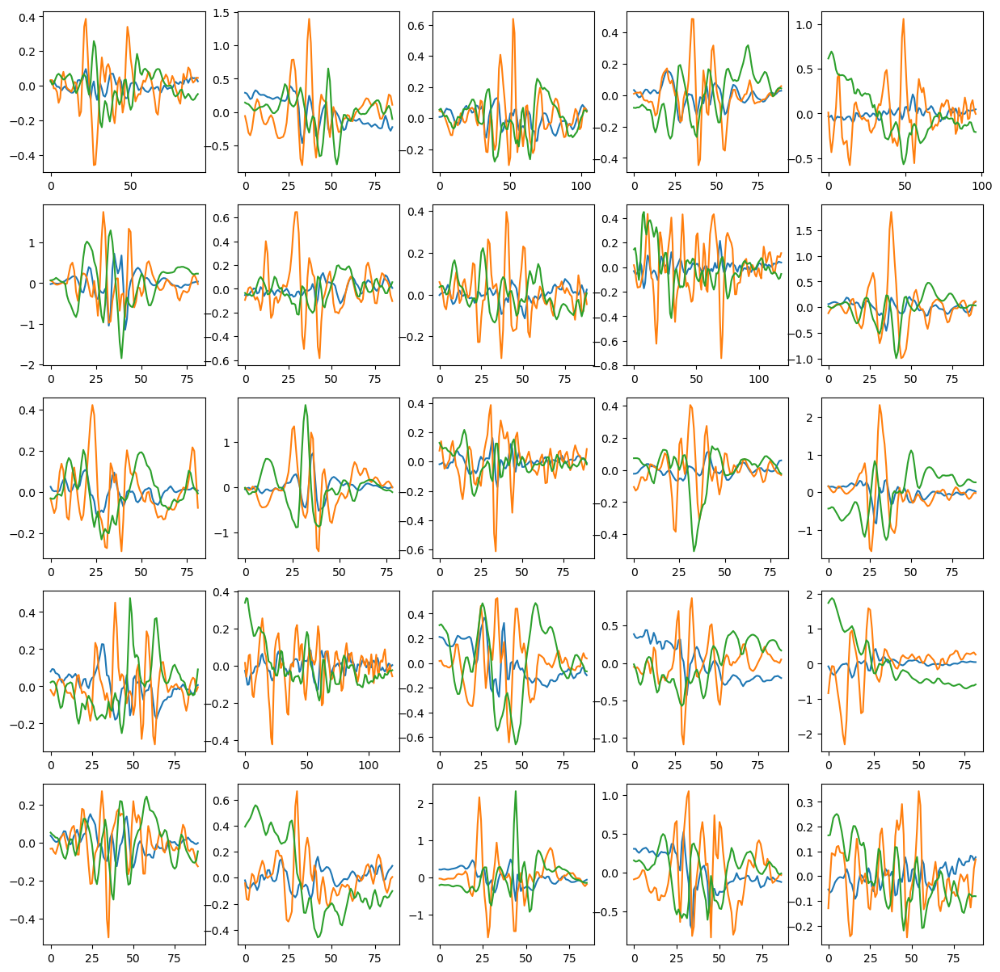

In [176]:
gesture  = "c"
mask = (Y[:, 0] == gesture) & (np.isin(Y[:,1], ["caroline", "amran", "anusha"])) #& (Y[:,2] == "3")
X_sel = [samples[i] for i in range(len(mask)) if mask[i]]
X_sel = [np.stack([sample["acc_x"], sample["acc_y"], sample["acc_z"]], axis=-1) for sample in X_sel]
X_sel = [x - x.mean(axis=0) for x in X_sel]
X_sel_sampled = [X_sel[i] for i in np.random.choice(len(X_sel), 25)]
fig, axes = plt.subplots(5, 5, figsize=(15, 15))
for i, ax in enumerate(axes.flatten()):
    ax.plot(X_sel_sampled[i])

In [178]:
gestures = {
    "a": "Swipe Up",
    "b": "Swipe Down",
    "c": "Swipe Left",
    "d": "Swipe Right",
    #"p": "Quick Pinch",
    "pc": "Pinch Close",
    "po": "Pinch Open",
    "sp": "Side Pinch",
}

fig, axes = plt.subplots(3, len(gestures), figsize=(30, 15), sharex=True, sharey="row", dpi=600)
for i, (gesture, name) in enumerate(gestures.items()):

    
    #ax.set_ylabel("Amplitude [m/s^2]", **plot_args)
    #ax.set_xlabel("Time [ms]", **plot_args)
    

    mask = (Y[:, 0] == gesture) & (np.isin(Y[:,1], ["caroline", "amran", "anusha"])) #& (Y[:,2] == "3")
    
    X_sel_dict = defaultdict(list)
    for j, sample in enumerate(samples):
        if mask[j]:
            
            X_sel_ppg = np.stack([sample[key] for key in sample.keys() if "ppg_green" in key], axis=-1)
            X_sel_ppg = X_sel_ppg - X_sel_ppg.mean(axis=0)
            X_sel_dict["ppg"].append(X_sel_ppg)
            
            X_sel_acc = np.stack([sample["acc_x"], sample["acc_y"], sample["acc_z"]], axis=-1)
            X_sel_acc = X_sel_acc - X_sel_acc.mean(axis=0)
            X_sel_dict["acc"].append(X_sel_acc)
            
            X_sel_gyro = np.stack([sample["gyro_x"], sample["gyro_y"], sample["gyro_z"]], axis=-1)
            X_sel_gyro = X_sel_gyro - X_sel_gyro.mean(axis=0)
            X_sel_dict["gyro"].append(X_sel_gyro)

    
    colors = [cmap(i) for i in range(16)]
    
    for k, modality in enumerate(X_sel_dict.keys()):
        ax = axes[k, i]
        X_sel = X_sel_dict[modality]
    
        dtw_args = {"penalty":0.001, "psi":0}
        if modality == "ppg":
            dtw_args["inner_dist "] = "euclidian"
        else:
            dtw_args["inner_dist "] = "squared euclidean"
        
        barycenter = overlay_signals(X_sel, ax=ax, colors=colors, top_k=10, num_samples=70,  max_i_barycenter = 40, iterations_barycenter = 20, dtw_args = dtw_args)
        if k == 0:
            ax.set_title(name, **plot_args)
        ax.label_outer()
        # remove axis
        #ax.axis("off")
        ax.tick_params(axis='both', which='both', labelsize=plot_args["fontsize"])
        for label in ax.get_xticklabels():
            label.set_fontproperties(plot_args["fontproperties"])
            label.set_fontsize(plot_args["fontsize"])
        for label in ax.get_yticklabels():
            label.set_fontproperties(plot_args["fontproperties"])
            label.set_fontsize(plot_args["fontsize"])
           
            
plt.subplots_adjust(hspace=0, wspace=0)
fig.text(0.5, 0.03, 'Time [ms]', ha='center', va='center', **plot_args)

fig.text(0.08, 0.75, 'PPG', ha='center', va='center', rotation='vertical', **plot_args)
fig.text(0.08, 0.5, 'Amplitude\n[m/s^2]', ha='center', va='center', rotation='vertical', **plot_args)
fig.text(0.08, 0.25, 'Angular Velocity\n[m/s^2]', ha='center', va='center', rotation='vertical', **plot_args)

axes[1, 0].set_ylim(-0.7, 0.7)
axes[2, 1].set_ylim(-50, 50)
axes[0,0].set_ylim(-500,500)

axes[1,0].legend(fontsize = plot_args["fontsize"]//2,title_fontsize = plot_args["fontsize"]//2, title="Axis", bbox_to_anchor=(1.05, 1), loc='upper left')




TypeError: DTWSettings.__init__() got an unexpected keyword argument 'inner_dist '

In [143]:
axes[1,0].legend(fontsize = plot_args["fontsize"]//2,title_fontsize = plot_args["fontsize"]//2, title="Axis",  loc='upper left',frameon=False)
fig.savefig("gesture_overlays.pdf", dpi=600, bbox_inches="tight")

In [145]:
for axi in axes:
    for ax in axi:
        ax.axis("off")
fig

In [144]:
for axi in axes:
    for ax in axi:
        ax.axis("off")
        
for t in fig.texts:
    t.remove()

fig.savefig("gesture_overlays_noaxis.pdf", dpi=600, bbox_inches="tight")

In [35]:
n_clusters = 3

#kmeans = KernelKMeans(n_clusters=3, kernel="gak", n_init=100, random_state=0)
kmeans = TimeSeriesKMeans(n_clusters=3, metric="dtw", n_init=1, random_state=0)
#kmeans = KShape(n_clusters=3, n_init=1, random_state=0)
clusters = kmeans.fit_predict(X)


KeyboardInterrupt: 

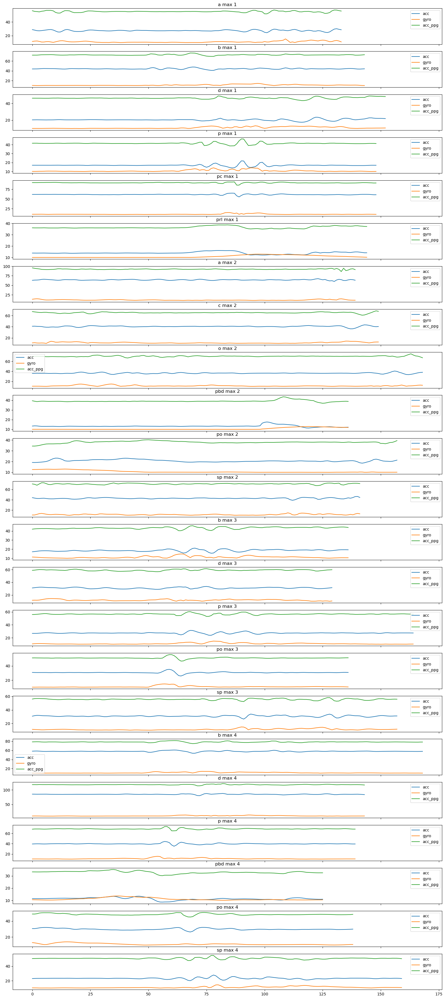

In [304]:
samples_max = []
for file in all_files:
    if "max" not in file:
        continue
    sample = import_hdf5_session(file, fixed_length=None)
    sample = compute_magnitudes(sample)
    samples_max += samplei

indices = list(range(0, len(samples_max), 30))
fig, axes = plt.subplots(len(indices), 1, figsize=(20, 2*len(indices)), sharex=True, sharey=False)
for k, i in enumerate(indices):
    axes[k].plot(samples_max[i]["acc"]/samples_max[i]["acc"].std(), label="acc")
    axes[k].plot(samples_max[i]["gyro"]/samples_max[i]["gyro"].std() + 10, label="gyro")
    axes[k].plot(samples_max[i]["acc_ppg"]/samples_max[i]["acc_ppg"].std() + 20, label="acc_ppg")
    axes[k].legend()
    axes[k].set_title(samples_max[i]["label"] + " " + samples_max[i]["participant"] + " " + samples_max[i]["session"])
    

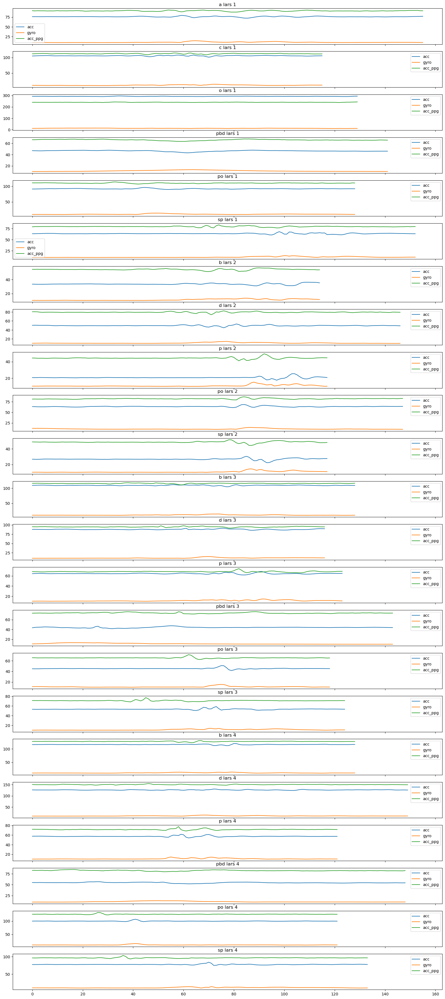

In [306]:
samples_max = []
for file in all_files:
    if "lars" not in file:
        continue
    sample = import_hdf5_session(file, fixed_length=None)
    sample = compute_magnitudes(sample)
    samples_max += sample

indices = list(range(0, len(samples_max), 30))
fig, axes = plt.subplots(len(indices), 1, figsize=(20, 2*len(indices)), sharex=True, sharey=False)
for k, i in enumerate(indices):
    axes[k].plot(samples_max[i]["acc"]/samples_max[i]["acc"].std(), label="acc")
    axes[k].plot(samples_max[i]["gyro"]/samples_max[i]["gyro"].std() + 10, label="gyro")
    axes[k].plot(samples_max[i]["acc_ppg"]/samples_max[i]["acc_ppg"].std() + 20, label="acc_ppg")
    axes[k].legend()
    axes[k].set_title(samples_max[i]["label"] + " " + samples_max[i]["participant"] + " " + samples_max[i]["session"])

In [349]:
samples = {}

for file in all_files:
    if "zhipeng" not in file.lower():
        continue
    print(file)
    sample = import_hdf5_session(file, fixed_length=None)
    samples[sample[0]["session"]] = sample

C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_Zhipeng\participant_Zhipeng_1.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_Zhipeng\participant_Zhipeng_2.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_Zhipeng\participant_Zhipeng_3.hdf5
C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_Zhipeng\participant_Zhipeng_4.hdf5


In [104]:

def normalize(signal):
    if signal.ndim == 1:
        return (signal - np.nanmean(signal)) / np.nanstd(signal)
    else: #ndim =2
        return (signal - np.nanmean(signal, axis=0, keepdims=True)) / np.nanstd(signal, axis=0, keepdims=True)

In [87]:
samples_session = samples["1"]
samples_labels = np.array([sample["label"] for sample in samples_session])


for label in np.unique(samples_labels):
    indices = np.where(samples_labels == label)[0]
    fig, axes = plt.subplots(len(indices), 1, figsize=(20, 2*len(indices)), sharex=True, sharey=False)
    for k, i in enumerate(indices):
        axes[k].plot(normalize(samples_session[i]["acc_z"]), label="acc_z")
        axes[k].plot(normalize(samples_session[i]["acc_x"]), label="acc_x")
        axes[k].plot(normalize(samples_session[i]["acc_y"]), label="acc_y")


        #axes[k].plot(samples_session[i]["acc_ppg_z"]/samples_session[i]["acc_ppg_z"].std() + 10, label="acc_ppg_z")
        #axes[k].plot(samples_session[i]["acc_ppg_x"]/samples_session[i]["acc_ppg_x"].std() + 10, label="acc_ppg_x")
        #axes[k].plot(samples_session[i]["acc_ppg_y"]/samples_session[i]["acc_ppg_y"].std() + 10, label="acc_ppg_y")
        axes[k].legend()
        axes[k].set_title(samples_session[i]["label"] + " " + samples_session[i]["participant"] + " " + samples_session[i]["session"])
    


NameError: name 'samples_labels' is not defined

In [140]:
file = [el for el in all_files if "mia" in el.lower()][0]
print(file)
sample = import_hdf5_sequences(file)

        

C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_mia\participant_mia_2.hdf5


<Axes: >

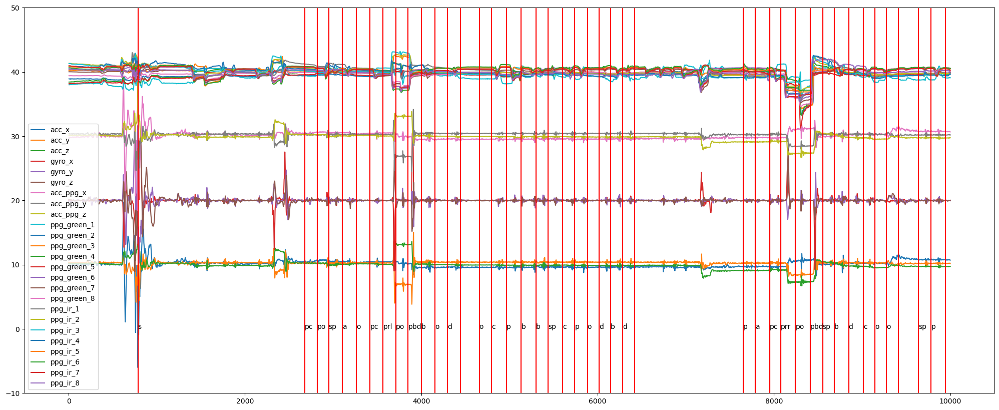

In [285]:
def normalize(signal):
    
    return (signal - np.nanmean(signal)) / np.nanstd(signal)

def plot_traces(sample, start_index, end_index, labels:np.array=None, label_times:np.array=None):

    
    fig, ax = plt.subplots(1, figsize=(25, 10))
    for acc in ["acc_x", "acc_y", "acc_z"]:
        ax.plot(normalize(sample[acc])[start_index:end_index] + 10, label=acc)
    for gyro in ["gyro_x", "gyro_y", "gyro_z"]:
        ax.plot(normalize(sample[gyro])[start_index:end_index]+20, label=gyro)
    for acc_ppg in ["acc_ppg_x", "acc_ppg_y", "acc_ppg_z"]:
        ax.plot(normalize(sample[acc_ppg])[start_index:end_index]+30, label=acc_ppg)
    for ppg in ["ppg_green_1", "ppg_green_2", "ppg_green_3", "ppg_green_4", "ppg_green_5", "ppg_green_6", "ppg_green_7", "ppg_green_8",\
                "ppg_ir_1", "ppg_ir_2", "ppg_ir_3", "ppg_ir_4", "ppg_ir_5", "ppg_ir_6", "ppg_ir_7", "ppg_ir_8",\
                ]:
        ax.plot(normalize(sample[ppg])[start_index:end_index]+40, label=ppg)
    ax.legend()
    ax.set_ylim(-10, 50)
    
    if labels is None:
        labels = sample["label"]
    if label_times is None:
        label_times = sample["label_indices"]
    
    for label_name, label_time in zip(labels, label_times):
        
        start_time, end_time = label_time
        if start_time < start_index or end_time > end_index:
            continue
        ax.axvline(start_time - start_index, color="red")
        ax.axvline(end_time - start_index, color="red")
        ax.text(start_time - start_index, 0, label_name)
    
    return ax
        
    
plot_traces(sample, start_index=0, end_index=10000)

In [126]:
samples = []
for file in all_files:
    sample = import_hdf5_session(file)
    samples.extend(sample)

In [127]:
acc_signals = [np.stack([sample["acc_x"], sample["acc_y"], sample["acc_z"]], axis=1) for sample in samples]

max_length = 170
acc_signals_padded = []
for signal in acc_signals:
    signal = normalize(signal)
    signal_length = signal.shape[0]
    if signal_length < max_length:
        pad_length = max_length - signal_length
        signal = np.pad(signal, ((pad_length//2, pad_length - pad_length//2), (0, 0)), "constant")
    elif signal_length > max_length:
        cut_length = signal_length - max_length
        signal = signal[cut_length//2:-cut_length//2, :]
    acc_signals_padded.append(signal)
acc_signals_padded = np.stack(acc_signals_padded)

In [129]:
from tslearn.clustering import TimeSeriesKMeans, KernelKMeans, KShape

model = TimeSeriesKMeans(n_clusters=3, metric="dtw", max_iter=50, random_state=10, n_jobs=-1)
#model = KShape(n_clusters=3, n_init=50, random_state=0)
#model = KernelKMeans(n_clusters=3, kernel="gak", n_init=50, random_state=0)
clusters = model.fit_predict(acc_signals_padded)


print(clusters)

[1 1 1 ... 0 2 0]


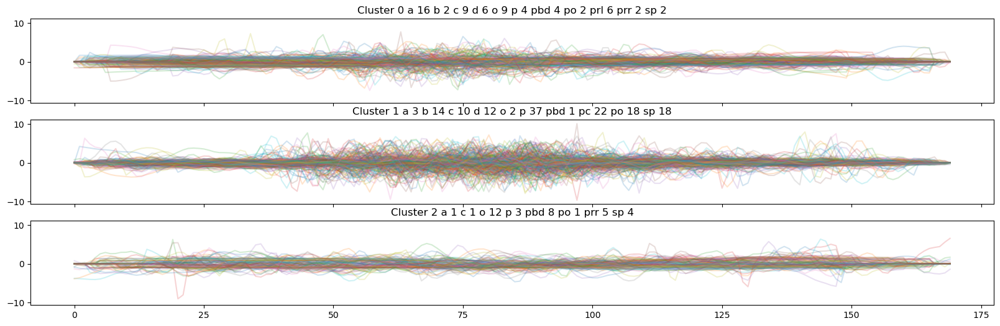

In [119]:
fig, axes = plt.subplots(3, 1, figsize=(20, 6), sharex=True, sharey=True)
for cluster in np.unique(clusters):
    indices = np.where(clusters == cluster)[0]
    labels, label_counts = np.unique([samples[i]["label"] for i in indices], return_counts=True)
    hist_str = " ".join([f"{label} {count}" for label, count in zip(labels, label_counts)])
    for i in indices:
        axes[cluster].plot(normalize(acc_signals_padded[i, :, :]), label=samples[i]["label"], alpha=0.2)

    axes[cluster].set_title(f"Cluster {cluster} {hist_str}")

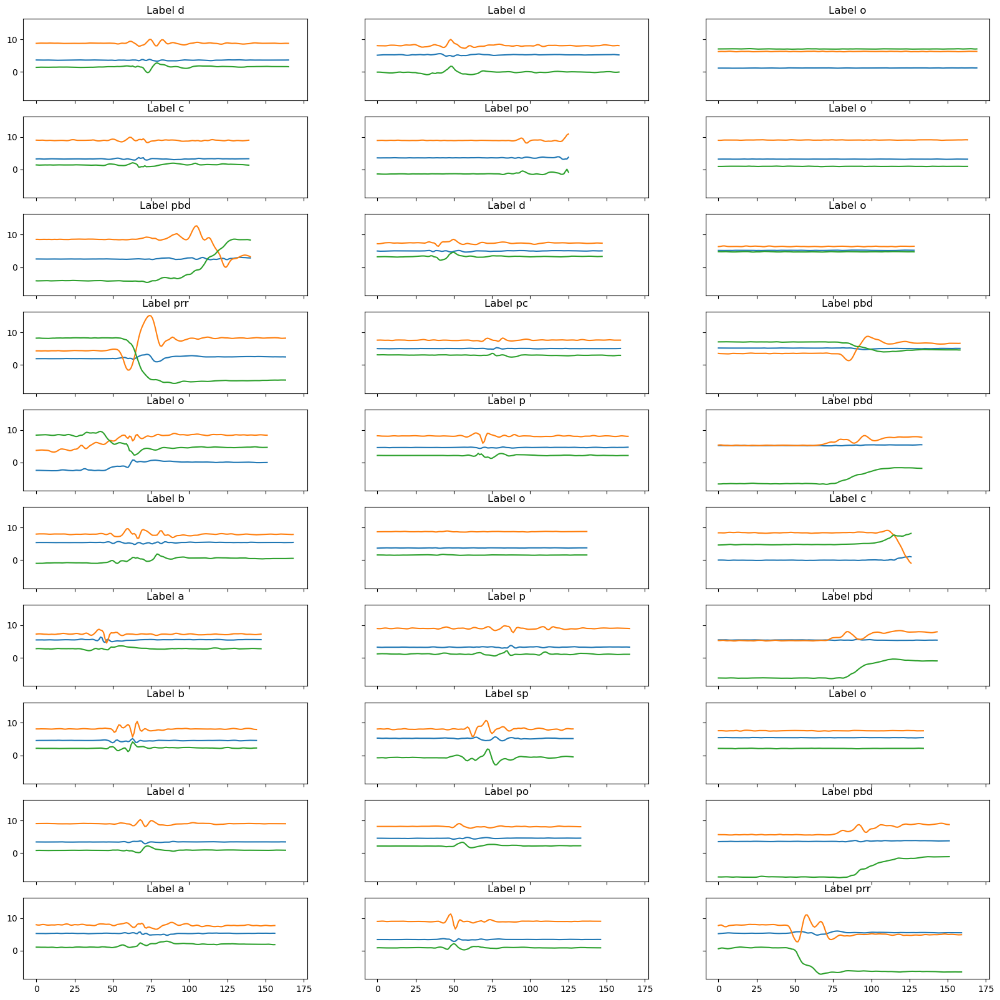

In [121]:
n_per_cluster = 10
fig, axes = plt.subplots(n_per_cluster, 3, figsize=(20, n_per_cluster*2), sharex=True, sharey=True)
for cluster in np.unique(clusters):
    indices = np.where(clusters == cluster)[0]
    np.random.shuffle(indices)
    for i in range(n_per_cluster):
        axes[i, cluster].plot(samples[indices[i]]["acc_x"], label=samples[indices[i]]["label"])
        axes[i, cluster].plot(samples[indices[i]]["acc_y"], label=samples[indices[i]]["label"])
        axes[i, cluster].plot(samples[indices[i]]["acc_z"], label=samples[indices[i]]["label"])
        axes[i, cluster].set_title(f"Label {samples[indices[i]]['label']}")


In [354]:
def correct_label_times(sample):

    label_times = np.array(sample["label_indices"])
    labels = np.array(sample["label"])

    def compute_energy(signals:list):
        return np.sum([(signal - np.nanmean(signal)) ** 2 for signal in signals], axis=0)

    def smooth_signal(signal, window_size=10):
        from scipy.ndimage import gaussian_filter1d
        return gaussian_filter1d(signal, window_size/2)

    def detect_peaks(signal):
        from scipy.signal import find_peaks, find_peaks_cwt
        peaks, _ = find_peaks(signal, distance=1, prominence=0.2)
        #peaks = find_peaks_cwt(signal, widths=np.arange(1, 10))
        return peaks

    def plot_peaks(peaks, signal, start_index, end_index, ax):
        for peak in peaks:
            if peak < start_index or peak > end_index:
                continue
            ax.plot(peak - start_index, signal[peak], "x", color="red")
        return ax

    signal_energy_gyro = compute_energy([sample["gyro_x"]/64, sample["gyro_y"]/16, sample["gyro_z"]/16])
    signal_energy_acc = compute_energy([sample["acc_x"]/1, sample["acc_y"]/1, sample["acc_z"]/1])
    signal_energy_ppg = compute_energy([sample["ppg_green_1"], sample["ppg_green_2"], sample["ppg_green_3"], sample["ppg_green_4"], sample["ppg_green_5"], sample["ppg_green_6"], sample["ppg_green_7"], sample["ppg_green_8"],\
                                        sample["ppg_ir_1"], sample["ppg_ir_2"], sample["ppg_ir_3"], sample["ppg_ir_4"], sample["ppg_ir_5"], sample["ppg_ir_6"], sample["ppg_ir_7"], sample["ppg_ir_8"]])
    #gaussian smoothing
    signal_energy_gyro = smooth_signal(signal_energy_gyro, window_size=15)
    signal_energy_acc = smooth_signal(signal_energy_acc, window_size=15)
    signal_energy_ppg = smooth_signal(signal_energy_ppg/2000000)
    signal_energy = signal_energy_gyro + signal_energy_acc
    #signal_energy = np.abs(np.diff(signal_energy))*16
    signal_energy_peaks = detect_peaks(signal_energy)


    argsort = np.argsort(label_times[:, 0])
    labels = labels[argsort]
    label_times = label_times[argsort]

    gesture_start, gesture_end = 100, 140

    gestures_start, gestures_end,  = label_times[gesture_start, 0], label_times[gesture_end, 1]


    all_shifts = {}

    prev_shift = 0
    for i, (label_start, label_end) in enumerate(label_times):
        #print(label_start, label_end)
        label_peaks = signal_energy_peaks[(signal_energy_peaks > label_start) & (signal_energy_peaks < label_end)]
        
        if len(label_peaks) == 0 or labels[i] in ["o", "pbd"]:
            shift = 0
        else:
            peaks_sizes = signal_energy[label_peaks]
            largest_peak = label_peaks[np.argmax(peaks_sizes)]
            
            shift = largest_peak - (label_start + label_end) / 2
        label_times[i, 0] += (shift + prev_shift)/2
        label_times[i, 1] += (shift + prev_shift)/2
        prev_shift = shift
        all_shifts[i] = shift


    #ax = plot_traces(sample, gestures_start, gestures_end, labels, label_times)
    #ax.plot(signal_energy[gestures_start:gestures_end] + 50, label="energy")
    #ax.plot(signal_energy_ppg[gestures_start:gestures_end] + 60, label="energy")


    #plot_peaks(signal_energy_peaks, signal_energy+50, gestures_start, gestures_end, ax)

    #ax.set_ylim(-10, 60)
    shift_mean = np.mean(list(all_shifts.values()))
    shift_std = np.std(list(all_shifts.values()))
    print(f"Mean shift: {shift_mean} Std shift: {shift_std}")
    print(all_shifts)
    sample["label_indices"] = label_times.tolist()
    
    return sample, list(all_shifts.values())


all_shifts = []
for file in all_files:
    sample = import_hdf5_sequences(file)
    sample, shifts = correct_label_times(sample)
    all_shifts.extend(shifts)
    save_file = file.replace("dataset", "dataset_corrected")
    os.makedirs(os.path.dirname(save_file), exist_ok=True)
    save_hd5f_sequence(save_file, sample, overwrite=True)



Mean shift: 3.791208791208791 Std shift: 24.466363162056833
{0: 0, 1: -41.0, 2: 49.0, 3: 11.5, 4: -15.0, 5: 18.0, 6: 12.0, 7: -4.0, 8: 31.5, 9: 18.5, 10: 29.5, 11: 61.5, 12: 51.0, 13: 10.5, 14: 22.0, 15: -34.0, 16: 6.0, 17: -17.0, 18: 49.5, 19: 2.5, 20: -5.0, 21: 45.0, 22: 33.0, 23: 36.5, 24: -5.0, 25: 55.0, 26: 15.5, 27: -10.5, 28: -22.0, 29: 13.0, 30: -1.0, 31: 0.0, 32: -14.0, 33: 4.5, 34: 19.0, 35: 25.5, 36: -10.5, 37: -12.0, 38: -60.0, 39: -75.5, 40: 66.5, 41: -15.0, 42: -7.5, 43: -24.0, 44: -2.5, 45: 50.0, 46: 42.5, 47: -43.0, 48: 43.5, 49: 31.5, 50: -57.5, 51: -44.0, 52: -6.0, 53: -13.0, 54: -19.5, 55: -6.5, 56: 5.5, 57: -1.0, 58: 12.5, 59: 72.0, 60: 62.0, 61: 20.0, 62: 65.0, 63: -29.5, 64: 64.0, 65: 62.5, 66: -63.5, 67: -40.5, 68: -3.5, 69: -27.0, 70: 17.0, 71: 22.0, 72: 1.5, 73: 54.5, 74: 21.5, 75: 9.5, 76: 36.0, 77: 14.5, 78: 15.0, 79: 0, 80: 33.5, 81: 8.5, 82: 28.0, 83: 28.5, 84: 7.0, 85: 5.0, 86: 0, 87: 10.5, 88: 17.0, 89: -46.0, 90: -1.0, 91: 0, 92: 0, 93: -66.0, 94: 9.5, 9

In [770]:
data = import_hdf5_sequences(r"C:\Users\lhauptmann\Code\WristPPG2\data\dataset\participant_pam\participant_pam_3.hdf5")

In [786]:
data["label"]

['a',
 'a',
 'a',
 'a',
 'a',
 'a',
 'a',
 'a',
 'a',
 'a',
 'a',
 'a',
 'a',
 'a',
 'b',
 'b',
 'b',
 'b',
 'b',
 'b',
 'b',
 'b',
 'b',
 'b',
 'b',
 'b',
 'b',
 'c',
 'c',
 'c',
 'c',
 'c',
 'c',
 'c',
 'c',
 'c',
 'c',
 'c',
 'c',
 'c',
 'c',
 'c',
 'd',
 'd',
 'd',
 'd',
 'd',
 'd',
 'd',
 'd',
 'd',
 'd',
 'd',
 'd',
 'd',
 'd',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o',
 'o'

findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: Font family 'Raleway' not found.
findfont: F

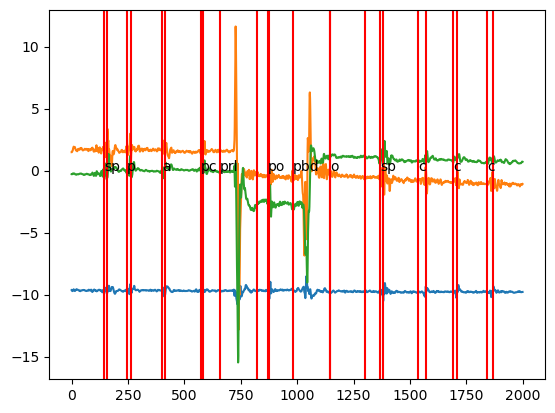

In [787]:


start_index = 5000
end_index = 7000
label_mask = np.array([el[0] > start_index and el[1] < end_index for el in data["label_indices"]])


acc = np.stack([data["acc_x"], data["acc_y"], data["acc_z"]], axis=-1)
plt.plot(acc[start_index:end_index])

for label, label_index in zip(np.array(data["label"])[label_mask], np.array(data["label_indices"])[label_mask]):
    plt.axvline(label_index[0] - start_index, color="red")
    plt.axvline(label_index[1] - start_index, color="red")
    plt.text(label_index[0] - start_index, 0, label)


In [778]:
sum(label_mask)

12